In [1]:
import pandas as pd
import requests
import json
import matplotlib.pyplot as plt
import numpy as np
from datetime import date
import math
import scipy.stats

# Import plotting tools
import plotly.graph_objects as go
import chart_studio.plotly
import seaborn as sns

# Machine Learning
from fbprophet import Prophet
from sklearn.model_selection import TimeSeriesSplit
import statsmodels.api # tsaplots only works when this is imported separately
import statsmodels as sm

# tqdm package to show progress in loops
from tqdm import tqdm

from pprint import pprint

In C:\Users\bradp\anaconda3\envs\Capstone3\lib\site-packages\matplotlib\mpl-data\stylelib\_classic_test.mplstyle: 
The text.latex.preview rcparam was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
In C:\Users\bradp\anaconda3\envs\Capstone3\lib\site-packages\matplotlib\mpl-data\stylelib\_classic_test.mplstyle: 
The mathtext.fallback_to_cm rcparam was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
In C:\Users\bradp\anaconda3\envs\Capstone3\lib\site-packages\matplotlib\mpl-data\stylelib\_classic_test.mplstyle: Support for setting the 'mathtext.fallback_to_cm' rcParam is deprecated since 3.3 and will be removed two minor releases later; use 'mathtext.fallback : 'cm' instead.
In C:\Users\bradp\anaconda3\envs\Capstone3\lib\site-packages\matplotlib\mpl-data\stylelib\_classic_test.mplstyle: 
The validate_bool_maybe_none function was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
In C:\Users\bradp\anaconda3\envs

In [2]:
import os
os.chdir('C:\\Users\\bradp\\OneDrive\\Documents\\Springboard\\Capstone 3')

# Data Wrangling

## Import EIA Generation Data by Source

In [3]:
# Energy Generation Data
# Data Source: https://www.eia.gov/opendata/qb.php?category=3390107
# Carolinas: http://api.eia.gov/series/?api_key=YOUR_API_KEY_HERE&series_id=EBA.CAR-ALL.NG.COL.H
# Midwest: http://api.eia.gov/series/?api_key=YOUR_API_KEY_HERE&series_id=EBA.MIDW-ALL.NG.HL

eia_key = '28a55d57cbafe259bc2b894a861822ea'
base_url = 'http://api.eia.gov/series'

# Generation Sources
Carolinas_Gen = ['EBA.CAR-ALL.NG.COL.H', 'EBA.CAR-ALL.NG.WAT.H', 'EBA.CAR-ALL.NG.NG.H', 'EBA.CAR-ALL.NG.NUC.H', 'EBA.CAR-ALL.NG.OTH.H', 'EBA.CAR-ALL.NG.OIL.H', 'EBA.CAR-ALL.NG.SUN.H']
Midwest_Gen = ['EBA.MIDW-ALL.NG.COL.H', 'EBA.MIDW-ALL.NG.WAT.H', 'EBA.MIDW-ALL.NG.NG.H', 'EBA.MIDW-ALL.NG.NUC.H', 'EBA.MIDW-ALL.NG.OTH.H', 'EBA.MIDW-ALL.NG.OIL.H', 'EBA.MIDW-ALL.NG.SUN.H']

# Net Generation
Carolinas_Net_Gen = ['EBA.CAR-ALL.NG.HL']
Midwest_Net_Gen = ['EBA.MIDW-ALL.NG.HL']

Labels = ['Coal', 'Hydro', 'Natural Gas', 'Nuclear', 'Other','Petroleum','Solar']

SERIES_ID = Carolinas_Gen
SERIES_NAME = Labels

#Initialize a list of dataframes (one for each generation source)
df_list_gen = []

In [4]:
# Convert each series' API data to a DataFrame and append DataFrames to list

for i in range(len(SERIES_ID)):
    url = base_url + '/?api_key=' + eia_key + '&series_id=' + SERIES_ID[i]
    r = requests.get(url)
    json_data = r.json()
    
    df = pd.DataFrame(json_data.get('series')[0].get('data'), columns = ['Date', SERIES_NAME[i]])
    df.set_index('Date', drop=True, inplace=True)
    df_list_gen.append(df)

In [5]:
# Convert list of dataframes to single dataframe
gen = pd.concat(df_list_gen, axis=1)

# Create date as datetype datatype
gen['Year'] = gen.index.astype(str).str[:4]
gen['Month'] = gen.index.astype(str).str[4:6]
gen['Day'] = gen.index.astype(str).str[6:8]
gen['Hour'] = gen.index.astype(str).str[9:11]
gen['Date'] = pd.to_datetime(gen[['Year','Month','Day','Hour']])

gen.set_index('Date',drop=True,inplace=True)
final_gen = gen.iloc[:,:7]

## Import EIA Demand Data

In [7]:
#eia_key = '28a55d57cbafe259bc2b894a861822ea'
#base_url = 'http://api.eia.gov/series'

#Labels = ['EBA.CAR-ALL.D.H']

#SERIES_ID = Carolinas_Demand
#SERIES_NAME = Labels

#Initialize a list of dataframes (one for each generation source)
#df_list_gen = []

### Region Represented by Generation Data
https://www.eia.gov/beta/electricity/gridmonitor/expanded-view/electric_overview/balancing_authority/DUK/ElectricStatusMap-12/edit
<img src = "Carolinas_Region.jpg", align='left'>

### Import Weather Data

In [8]:
# Average weather needs to be approximated across region; using Raleigh for North Carolina and Columbia for South Carolina
# NCEI API Documentation: https://www.ncei.noaa.gov/support/access-data-service-api-user-documentation

today = date.today().strftime("%Y-%m-%d")

ColumbiaSC_ID = '72310013883'
RaleighNC_ID = '72306013722'

ColumbiaSC_url = 'https://www.ncei.noaa.gov/access/services/data/v1?dataset=local-climatological-data&stations=' + ColumbiaSC_ID + '&startDate=2018-07-01&endDate=' + today + '&includeAttributes=true&format=json'
ColumbiaSC_data = requests.get(ColumbiaSC_url).json()
ColumbiaSC_df = pd.DataFrame(ColumbiaSC_data)[['DATE','HourlyDryBulbTemperature']]
print('Columbia, SC Temperatures')
print(ColumbiaSC_df.head())

RaleighNC_url = 'https://www.ncei.noaa.gov/access/services/data/v1?dataset=local-climatological-data&stations=' + RaleighNC_ID + '&startDate=2018-07-01&endDate=' + today + '&includeAttributes=true&format=json'
RaleighNC_data = requests.get(RaleighNC_url).json()
RaleighNC_df = pd.DataFrame(RaleighNC_data)[['DATE','HourlyDryBulbTemperature']]
print('Raleigh, NC Temperatures')
print(RaleighNC_df.head())

Columbia, SC Temperatures
                  DATE HourlyDryBulbTemperature
0  2018-07-01T00:56:00                       78
1  2018-07-01T01:00:00                       78
2  2018-07-01T01:56:00                       77
3  2018-07-01T02:56:00                       77
4  2018-07-01T03:56:00                       76
Raleigh, NC Temperatures
                  DATE HourlyDryBulbTemperature
0  2018-07-01T00:27:00                       77
1  2018-07-01T00:51:00                       78
2  2018-07-01T01:00:00                       78
3  2018-07-01T01:51:00                       77
4  2018-07-01T02:51:00                       76


In [9]:
# Make DATE column the index
ColumbiaSC_df.set_index('DATE', drop=True, inplace=True)
RaleighNC_df.set_index('DATE', drop=True, inplace=True)

In [10]:
# Convert indices to datetime
ColumbiaSC_df.index = pd.to_datetime(ColumbiaSC_df.index)
RaleighNC_df.index = pd.to_datetime(RaleighNC_df.index)

#### Weather Data -- Cleaning

In [11]:
# Find non-numbers in Columbia SC weather
print('Non-numbers in NCEI data')
for index, row in ColumbiaSC_df.iterrows():
    try:
        pd.to_numeric(row)
    except:
        print(index, row['HourlyDryBulbTemperature'])

Non-numbers in NCEI data
2018-07-29 13:54:00 72s
2018-10-23 11:56:00 74s
2018-11-04 12:56:00 68s
2018-11-04 13:00:00 68s
2019-01-27 11:56:00 54s
2019-02-14 13:56:00 66s
2019-06-20 15:42:00 72s
2019-06-20 15:52:00 72s
2019-06-20 16:14:00 72s
2019-06-20 16:40:00 72s
2019-06-20 16:56:00 72s
2019-12-16 14:56:00 74s
2020-03-02 12:56:00 69s
2020-03-02 13:00:00 69s
2020-03-09 13:56:00 72s
2020-12-28 13:56:00 63s
2021-03-31 17:56:00 *
2021-05-03 15:56:00 *


In [12]:
# Find non-numbers in Raleigh NC weather
for index, row in RaleighNC_df.iterrows():
    try:
        pd.to_numeric(row)
    except:
        print(index, row['HourlyDryBulbTemperature'])

2018-08-08 17:58:00 69s
2019-08-21 18:51:00 72s
2021-03-13 18:51:00 58s
2021-03-18 16:26:00 73s
2021-03-20 05:51:00 31s
2021-03-20 06:51:00 31s


In [13]:
# Remove 's' tags from temperatures
ColumbiaSC_df.replace('s','', regex=True, inplace=True)
RaleighNC_df.replace('s','', regex=True, inplace=True)

# Replace * rows with np.NaN and fill value
ColumbiaSC_df.replace('*',np.NaN, inplace=True)
RaleighNC_df.replace('*',np.NaN, inplace=True)
ColumbiaSC_df.fillna(method='bfill', inplace=True)
RaleighNC_df.fillna(method='bfill', inplace=True)


# Convert to numeric
ColumbiaSC_df['HourlyDryBulbTemperature'] = pd.to_numeric(ColumbiaSC_df['HourlyDryBulbTemperature'])
RaleighNC_df['HourlyDryBulbTemperature'] = pd.to_numeric(RaleighNC_df['HourlyDryBulbTemperature'])

# Fill missing values with linear interpolation
ColumbiaSC_df = ColumbiaSC_df.interpolate(method='linear')
RaleighNC_df = RaleighNC_df.interpolate(method='linear')

# Resample to 1 hour intervals
ColumbiaSC_df = ColumbiaSC_df.resample('1H').mean()
RaleighNC_df = RaleighNC_df.resample('1H').mean()

ColumbiaSC_df.columns = ['Columbia']
RaleighNC_df.columns = ['Raleigh']

# Merge dataframes on index
temperature_df = pd.merge(ColumbiaSC_df, RaleighNC_df, left_index=True, right_index=True)
temperature_df['Avg_Recorded'] = temperature_df.mean(axis=1)

### Add simulated-day-ahead weather forecast

In [14]:
# Created "simulated" day-ahead forecast from historical weather based on average error in predictions
# MAE of 1.39C from: https://www.mdpi.com/1996-1073/12/7/1309/pdf

day_df = temperature_df.resample('1D').mean()
day_df['Error'] = np.random.normal(0,1.39*(9/5),len(day_df))
daily_error = day_df['Error'].resample('1H').fillna('ffill')
daily_errors = daily_error.iloc[:len(temperature_df)]

In [15]:
# Create "simulated" historical forecast
temperature_df['Sim_1Day_TempForecast'] = temperature_df['Avg_Recorded'] + np.round(daily_errors,2)

# Forward fill few remaining hours from partial day
temperature_df.fillna(method='ffill', inplace=True)
temperature_df.head()

,Columbia,Raleigh,Avg_Recorded,Sim_1Day_TempForecast
DATE,,,,
2018-07-01 00:00:00,78.0,77.5,77.75,75.36
2018-07-01 01:00:00,77.5,77.5,77.50,75.11
2018-07-01 02:00:00,77.0,76.0,76.50,74.11
2018-07-01 03:00:00,76.0,74.0,75.00,72.61
2018-07-01 04:00:00,76.0,74.0,75.00,72.61


#### Merge Weather Data with Generation Data

In [16]:
# Add total generation
final_gen['Total_Renewables'] = final_gen.iloc[:,[1,3,6]].sum(axis=1)
final_gen['Total_Generation (MW)'] = final_gen.iloc[:,:7].sum(axis=1)
final_gen.head()

,Coal,Hydro,Natural Gas,Nuclear,Other,Petroleum,Solar,Total_Renewables,Total_Generation (MW)
Date,,,,,,,,,
2021-05-12 04:00:00,3886,226,5294,9969,813,0,-1,10194,20187
2021-05-12 03:00:00,4781,802,5753,9970,908,0,-1,10771,22213
2021-05-12 02:00:00,5209,1368,6333,9969,926,-1,-3,11334,23801
2021-05-12 01:00:00,5227,1539,6925,9968,926,-1,-1,11506,24583
2021-05-12 00:00:00,5264,1542,6979,9970,897,-1,206,11718,24857


In [17]:
# Merge Generation data with temperatures
df = pd.merge(final_gen, temperature_df['Sim_1Day_TempForecast'], left_index=True, right_index=True)

# Reverse Order
df = df.iloc[::-1]
df.tail()

,Coal,Hydro,Natural Gas,Nuclear,Other,Petroleum,Solar,Total_Renewables,Total_Generation (MW),Sim_1Day_TempForecast
2021-05-10 21:00:00,5590,1468,7887,10015,915,0,1923,13406,27798,65.39
2021-05-10 22:00:00,5665,1515,8067,10027,913,0,1525,13067,27712,63.89
2021-05-10 23:00:00,5705,1721,8261,10020,916,0,756,12497,27379,61.14
2021-05-11 00:00:00,5708,1683,8161,10016,919,0,207,11906,26694,61.78
2021-05-11 01:00:00,5724,1452,8139,10022,945,0,-2,11472,26280,61.78


# EDA

## Plot Generation Data by Power Plant Type

In [18]:
fig = go.Figure()

# Add traces
for i in range(len(final_gen.columns)):
    fig.add_trace(go.Scatter(x=final_gen.index, y=final_gen.iloc[:,i],
                    mode='lines',
                    name=final_gen.columns[i],
                    line_width=1))

# Label Graph
fig.update_layout(
    title="Generation Capacity (MW) by Plant Type",
    xaxis_title="Date",
    yaxis_title="Generation Capacity (MW)",
    legend_title="Legend Title",
    font=dict(
        family="Ariel",
        size=12,
        color="Black"
    )
)
fig.show()

#### Generation Source contribution to total generation capacity

## Investigate ACF and PACF of Generation Times Series

In [19]:
# Extract datetime and total generation
X = df.index
y = df.iloc[:,-2]

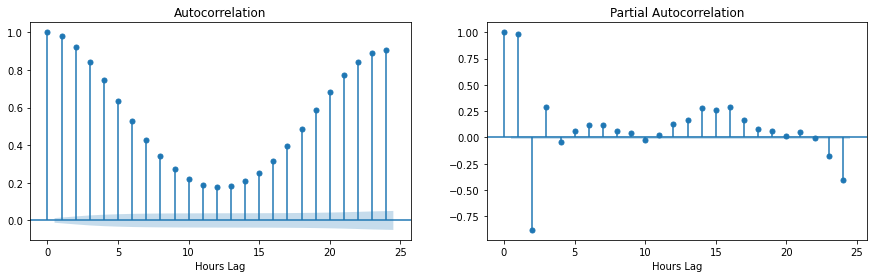

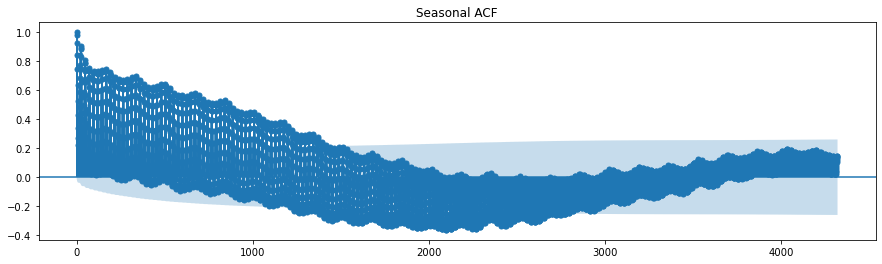

In [20]:
# Graph data
fig, axes = plt.subplots(1, 2, figsize=(15,4))
axes[0].set_xlabel('Hours Lag')
axes[1].set_xlabel('Hours Lag')

fig = sm.graphics.tsaplots.plot_acf(y, lags=24, ax=axes[0])
fig = sm.graphics.tsaplots.plot_pacf(y, lags=24, ax=axes[1])


fig, ax = plt.subplots(figsize=(15,4))
fig = sm.graphics.tsaplots.plot_acf(y, lags=180*24, ax=ax, title='Seasonal ACF')

The ACF plot is in line with expectations. The power consumption during any hour is highly correlated with the previous hour. The power consumption 24 hours away (during the same hour of the next day) is also highly correlated. The lowest correlation is halfway through the day (e.g. temperature at noon poorly predicts temperature at midnight).

The long-term ACF plot shows that the series becomes less correlated with itself as it approaches a lag of around 2000 hours. With 8760 hours per year, this is approximately the time between seasons.

## Correlation Analysis

### Corelations between Generation Sources

In [21]:
gen_sources = df.iloc[:,0:7].drop('Petroleum', axis=1)
gen_sources.tail()

,Coal,Hydro,Natural Gas,Nuclear,Other,Solar
2021-05-10 21:00:00,5590,1468,7887,10015,915,1923
2021-05-10 22:00:00,5665,1515,8067,10027,913,1525
2021-05-10 23:00:00,5705,1721,8261,10020,916,756
2021-05-11 00:00:00,5708,1683,8161,10016,919,207
2021-05-11 01:00:00,5724,1452,8139,10022,945,-2


The Pyplot chart of generation sources shows that Petroleum's contribution is negligible to the total generation capacity and can be ignored. Coal and natural gas have large seasonal swings. Nuclear also shows seasonal swings but stays within a tighter range, providing more of a baseload output. The seasonal trends are harder to see for solar, which are obscured by the strong linear trend of increased capacity over time as well as by daily variations in weather.

Hydro fluctuates between negative and positive capacity. I am not sure what the negative capacity represents, unless it represents being forced to run hydroelectric plants after rainfall at times when there is no demand for additional electricity. The prevalence of occurrence suggests it is not a data error.

In [22]:
gen_sources.corr()

,Coal,Hydro,Natural Gas,Nuclear,Other,Solar
Coal,1.000000,0.298253,0.669870,0.180046,0.489645,0.047501
Hydro,0.298253,1.000000,0.462030,-0.002192,0.249344,0.058661
Natural Gas,0.669870,0.462030,1.000000,0.115240,0.654151,0.010286
Nuclear,0.180046,-0.002192,0.115240,1.000000,0.349551,-0.018334
Other,0.489645,0.249344,0.654151,0.349551,1.000000,-0.121179
Solar,0.047501,0.058661,0.010286,-0.018334,-0.121179,1.000000


<AxesSubplot:>

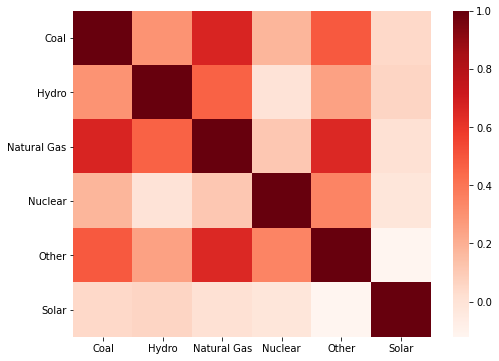

In [23]:
fig, ax = plt.subplots(figsize=(8,6))
sns.heatmap(gen_sources.corr(), axes=ax, cmap='Reds')

As inferred from the time series plots, coal and natural gas plant outputs are highly correlated with each other.

### Correlation with Exogenous Variable

In [24]:
gen_temp = df.iloc[:,-2:]
gen_temp.head()

,Total_Generation (MW),Sim_1Day_TempForecast
2018-07-01 05:00:00,26539,72.86
2018-07-01 06:00:00,24971,75.11
2018-07-01 07:00:00,23889,76.61
2018-07-01 08:00:00,23048,82.11
2018-07-01 09:00:00,22493,85.11


In [25]:
# Correlation coefficient and p-value
scipy.stats.pearsonr(gen_temp.iloc[:,0],gen_temp.iloc[:,1])

(0.16334686523434672, 1.7039491506282936e-149)

The correlation between the 1-day temperature forecast and total plant generation is weak but highly significant.

## ARIMA -- Autofit AR and MA paramaters

In [26]:
# Silence warnings
import warnings
warnings.filterwarnings('ignore')

#from statsmodels.tsa.arima_process import arma_generate_sample

#best_arma = statsmodels.tsa.stattools.arma_order_select_ic(y, max_ar=4, max_ma=4, ic='bic', trend='c', model_kw=None, fit_kw=None)
#best_arma['bic']

In [27]:
# Plot heatmap of SNS
#sns.heatmap(best_arma['bic'].iloc[1:,1:])
#plt.xlabel('MA')
#plt.ylabel('AR')

An AR of 4 and MA of 3 gives lowest BIC.

## ARIMA Model -- Order (4,1,3)

### 1. Try fitting on all data

In [28]:
from statsmodels.tsa.statespace.sarimax import SARIMAX
model = SARIMAX(y, order=(4,1,3))

In [29]:
# FIt ARIMA model 24 hours in advance
res = model.fit(steps=24)
print(res.summary())

                                 SARIMAX Results                                 
Dep. Variable:     Total_Generation (MW)   No. Observations:                25077
Model:                  SARIMAX(4, 1, 3)   Log Likelihood             -187148.275
Date:                   Thu, 13 May 2021   AIC                         374312.550
Time:                           05:01:55   BIC                         374377.588
Sample:                       07-01-2018   HQIC                        374333.598
                            - 05-11-2021                                         
Covariance Type:                     opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          3.4370      0.007    495.170      0.000       3.423       3.451
ar.L2         -4.6405      0.018   -263.428      0.000      -4.675      -4.606
ar.L3          2.9206      0

In [30]:
predict = res.get_prediction(start=0, end=len(y))
predicted_1day = predict.predicted_mean

# Calculate mean absolute percentage error of ARIMA
np.mean(np.abs(predicted_1day - y)/np.abs(y))

0.012582171818160438

In [31]:
sarimax_df = pd.merge(predicted_1day, y, left_index=True, right_index=True)
sarimax_df['SARIMAX_ERROR'] = sarimax_df.iloc[:,-1]-sarimax_df.iloc[:,-2]
sarimax_df.head()

,predicted_mean,Total_Generation (MW),SARIMAX_ERROR
2018-07-01 05:00:00,0.000000,26539,26539.000000
2018-07-01 06:00:00,34686.002547,24971,-9715.002547
2018-07-01 07:00:00,22035.879509,23889,1853.120491
2018-07-01 08:00:00,22355.004124,23048,692.995876
2018-07-01 09:00:00,22139.783762,22493,353.216238


### 2. Split ARIMA into 20 different training sets and make 1-day forecasts

In [32]:
# Address LU decomposition error in SARIMAX
# Suggestion from: https://github.com/statsmodels/statsmodels/issues/5459
from scipy import linalg
print(linalg.lapack.dgetrf([np.nan]))
print(linalg.lapack.dgetrf([np.inf]))

(array([nan]), array([0], dtype=int32), 0)
(array([inf]), array([0], dtype=int32), 0)


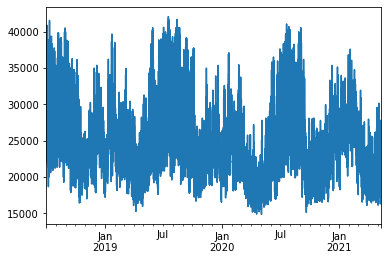

In [75]:
# Quick visual check of data before beginning long loop
y = df.iloc[:,-2].plot()

In [69]:
# Create a loop to test a 24 hour prediction for each time series split

tscv = TimeSeriesSplit(n_splits=20)

# Train-Test Split
X = df.index
y = df.iloc[:,-2]

actuals = []
predictions = []


for train_index, test_index in tqdm(tscv.split(X)):
    y_train, y_test = y[train_index], y[test_index]

    # Define model
    model = SARIMAX(y_train, order=(4,1,3))

    # FIt ARIMA model
    res = model.fit()
    
    # Get 24-hour prediction
    predict = res.get_prediction(start=len(y_train), end=len(y_train)+23) # get_prediction includes endpoint, unlike slicing
    predicted_1day = predict.predicted_mean
    
    # Get corresponding actual
    actual = y[len(y_train):len(y_train)+24]
    
    # Append to corresponding lists of actuals versus predictions
    actuals.append(actual)
    predictions.append(predicted_1day)
    
    # Print data to check for issues
    print(actual)
    print(predicted_1day)

1it [00:01,  1.17s/it]

2018-08-20 02:00:00    30555
2018-08-20 03:00:00    28498
2018-08-20 04:00:00    26644
2018-08-20 05:00:00    25260
2018-08-20 06:00:00    24301
2018-08-20 07:00:00    23692
2018-08-20 08:00:00    23092
2018-08-20 09:00:00    22916
2018-08-20 10:00:00    23528
2018-08-20 11:00:00    25166
2018-08-20 12:00:00    25588
2018-08-20 13:00:00    26251
2018-08-20 14:00:00    27426
2018-08-20 15:00:00    28993
2018-08-20 16:00:00    30551
2018-08-20 17:00:00    32201
2018-08-20 18:00:00    33944
2018-08-20 19:00:00    34922
2018-08-20 20:00:00    36275
2018-08-20 21:00:00    36507
2018-08-20 22:00:00    36439
2018-08-20 23:00:00    35927
2018-08-21 00:00:00    34950
2018-08-21 01:00:00    34410
Freq: H, Name: Total_Generation (MW), dtype: int64
2018-08-20 02:00:00    31139.208171
2018-08-20 03:00:00    30502.914012
2018-08-20 04:00:00    29682.223169
2018-08-20 05:00:00    28973.399242
2018-08-20 06:00:00    28314.922611
2018-08-20 07:00:00    27689.064121
2018-08-20 08:00:00    27325.545112
2

2it [00:03,  1.95s/it]

2018-10-08 20:00:00    33627
2018-10-08 21:00:00    33975
2018-10-08 22:00:00    33468
2018-10-08 23:00:00    32656
2018-10-09 00:00:00    32357
2018-10-09 01:00:00    31070
2018-10-09 02:00:00    28951
2018-10-09 03:00:00    26607
2018-10-09 04:00:00    24609
2018-10-09 05:00:00    23197
2018-10-09 06:00:00    21895
2018-10-09 07:00:00    21223
2018-10-09 08:00:00    21001
2018-10-09 09:00:00    20798
2018-10-09 10:00:00    21747
2018-10-09 11:00:00    23425
2018-10-09 12:00:00    24221
2018-10-09 13:00:00    24709
2018-10-09 14:00:00    25306
2018-10-09 15:00:00    26489
2018-10-09 16:00:00    27916
2018-10-09 17:00:00    29399
2018-10-09 18:00:00    30292
2018-10-09 19:00:00    30734
Freq: H, Name: Total_Generation (MW), dtype: int64
2018-10-08 20:00:00    33388.745373
2018-10-08 21:00:00    33593.206214
2018-10-08 22:00:00    33329.934962
2018-10-08 23:00:00    32743.201800
2018-10-09 00:00:00    31812.216382
2018-10-09 01:00:00    30698.895564
2018-10-09 02:00:00    29462.150343
2

3it [00:06,  2.41s/it]

2018-11-27 14:00:00    30667
2018-11-27 15:00:00    29331
2018-11-27 16:00:00    28081
2018-11-27 17:00:00    27326
2018-11-27 18:00:00    26346
2018-11-27 19:00:00    25851
2018-11-27 20:00:00    25402
2018-11-27 21:00:00    25678
2018-11-27 22:00:00    26909
2018-11-27 23:00:00    29266
2018-11-28 00:00:00    30428
2018-11-28 01:00:00    30734
2018-11-28 02:00:00    30636
2018-11-28 03:00:00    30118
2018-11-28 04:00:00    29291
2018-11-28 05:00:00    28143
2018-11-28 06:00:00    27753
2018-11-28 07:00:00    27407
2018-11-28 08:00:00    27578
2018-11-28 09:00:00    28036
2018-11-28 10:00:00    29124
2018-11-28 11:00:00    31270
2018-11-28 12:00:00    34118
2018-11-28 13:00:00    34983
Freq: H, Name: Total_Generation (MW), dtype: int64
2018-11-27 14:00:00    31323.665978
2018-11-27 15:00:00    31393.366512
2018-11-27 16:00:00    31108.527081
2018-11-27 17:00:00    30653.659154
2018-11-27 18:00:00    30034.587677
2018-11-27 19:00:00    29349.011236
2018-11-27 20:00:00    28631.576592
2

4it [00:10,  2.83s/it]

2019-01-16 08:00:00    26702
2019-01-16 09:00:00    27030
2019-01-16 10:00:00    27772
2019-01-16 11:00:00    29768
2019-01-16 12:00:00    32767
2019-01-16 13:00:00    34065
2019-01-16 14:00:00    33138
2019-01-16 15:00:00    30497
2019-01-16 16:00:00    28276
2019-01-16 17:00:00    26724
2019-01-16 18:00:00    25487
2019-01-16 19:00:00    24951
2019-01-16 20:00:00    24189
2019-01-16 21:00:00    23869
2019-01-16 22:00:00    24017
2019-01-16 23:00:00    25343
2019-01-17 00:00:00    27075
2019-01-17 01:00:00    27378
2019-01-17 02:00:00    27761
2019-01-17 03:00:00    27453
2019-01-17 04:00:00    26808
2019-01-17 05:00:00    26314
2019-01-17 06:00:00    26050
2019-01-17 07:00:00    26051
Freq: H, Name: Total_Generation (MW), dtype: int64
2019-01-16 08:00:00    26304.583417
2019-01-16 09:00:00    25746.505616
2019-01-16 10:00:00    25497.411974
2019-01-16 11:00:00    25394.570000
2019-01-16 12:00:00    25327.269321
2019-01-16 13:00:00    25325.014577
2019-01-16 14:00:00    25452.987486
2

5it [00:15,  3.88s/it]

2019-03-07 02:00:00    29982
2019-03-07 03:00:00    29969
2019-03-07 04:00:00    28840
2019-03-07 05:00:00    28446
2019-03-07 06:00:00    28462
2019-03-07 07:00:00    28732
2019-03-07 08:00:00    29209
2019-03-07 09:00:00    29726
2019-03-07 10:00:00    30360
2019-03-07 11:00:00    32650
2019-03-07 12:00:00    34711
2019-03-07 13:00:00    34938
2019-03-07 14:00:00    33787
2019-03-07 15:00:00    31470
2019-03-07 16:00:00    29022
2019-03-07 17:00:00    27568
2019-03-07 18:00:00    26478
2019-03-07 19:00:00    25261
2019-03-07 20:00:00    24152
2019-03-07 21:00:00    23398
2019-03-07 22:00:00    23528
2019-03-07 23:00:00    24035
2019-03-08 00:00:00    25698
2019-03-08 01:00:00    26380
Freq: H, Name: Total_Generation (MW), dtype: int64
2019-03-07 02:00:00    30245.959559
2019-03-07 03:00:00    30264.817685
2019-03-07 04:00:00    29818.910212
2019-03-07 05:00:00    29160.784391
2019-03-07 06:00:00    28533.249127
2019-03-07 07:00:00    28112.860046
2019-03-07 08:00:00    27983.889321
2

6it [00:22,  4.70s/it]

2019-04-25 20:00:00    25666
2019-04-25 21:00:00    25864
2019-04-25 22:00:00    25887
2019-04-25 23:00:00    25203
2019-04-26 00:00:00    25031
2019-04-26 01:00:00    25404
2019-04-26 02:00:00    24530
2019-04-26 03:00:00    22873
2019-04-26 04:00:00    21431
2019-04-26 05:00:00    19948
2019-04-26 06:00:00    19174
2019-04-26 07:00:00    18595
2019-04-26 08:00:00    17938
2019-04-26 09:00:00    17944
2019-04-26 10:00:00    18617
2019-04-26 11:00:00    20195
2019-04-26 12:00:00    21061
2019-04-26 13:00:00    21547
2019-04-26 14:00:00    22024
2019-04-26 15:00:00    22561
2019-04-26 16:00:00    23037
2019-04-26 17:00:00    23379
2019-04-26 18:00:00    23626
2019-04-26 19:00:00    23798
Freq: H, Name: Total_Generation (MW), dtype: int64
2019-04-25 20:00:00    25766.362578
2019-04-25 21:00:00    26147.598667
2019-04-25 22:00:00    26290.411127
2019-04-25 23:00:00    26166.270291
2019-04-26 00:00:00    25775.012485
2019-04-26 01:00:00    25144.959970
2019-04-26 02:00:00    24328.372535
2

7it [00:30,  6.03s/it]

2019-06-14 14:00:00    22012
2019-06-14 15:00:00    22588
2019-06-14 16:00:00    22966
2019-06-14 17:00:00    23738
2019-06-14 18:00:00    24525
2019-06-14 19:00:00    25294
2019-06-14 20:00:00    26156
2019-06-14 21:00:00    26996
2019-06-14 22:00:00    27486
2019-06-14 23:00:00    27490
2019-06-15 00:00:00    26639
2019-06-15 01:00:00    25351
2019-06-15 02:00:00    24633
2019-06-15 03:00:00    23035
2019-06-15 04:00:00    21368
2019-06-15 05:00:00    19780
2019-06-15 06:00:00    18702
2019-06-15 07:00:00    18180
2019-06-15 08:00:00    17747
2019-06-15 09:00:00    17609
2019-06-15 10:00:00    17665
2019-06-15 11:00:00    17736
2019-06-15 12:00:00    18457
2019-06-15 13:00:00    19600
Freq: H, Name: Total_Generation (MW), dtype: int64
2019-06-14 14:00:00    22506.486956
2019-06-14 15:00:00    23458.944547
2019-06-14 16:00:00    24373.924478
2019-06-14 17:00:00    25214.925478
2019-06-14 18:00:00    25940.840807
2019-06-14 19:00:00    26507.460179
2019-06-14 20:00:00    26872.233731
2

8it [00:38,  6.43s/it]

2019-08-03 08:00:00    21602
2019-08-03 09:00:00    21239
2019-08-03 10:00:00    21080
2019-08-03 11:00:00    21081
2019-08-03 12:00:00    21456
2019-08-03 13:00:00    22676
2019-08-03 14:00:00    24172
2019-08-03 15:00:00    25649
2019-08-03 16:00:00    27297
2019-08-03 17:00:00    29072
2019-08-03 18:00:00    30786
2019-08-03 19:00:00    32157
2019-08-03 20:00:00    33133
2019-08-03 21:00:00    33982
2019-08-03 22:00:00    34089
2019-08-03 23:00:00    33702
2019-08-04 00:00:00    32734
2019-08-04 01:00:00    31354
2019-08-04 02:00:00    29907
2019-08-04 03:00:00    28056
2019-08-04 04:00:00    26156
2019-08-04 05:00:00    24326
2019-08-04 06:00:00    22978
2019-08-04 07:00:00    21964
Freq: H, Name: Total_Generation (MW), dtype: int64
2019-08-03 08:00:00    21875.579934
2019-08-03 09:00:00    21946.956421
2019-08-03 10:00:00    22384.142117
2019-08-03 11:00:00    23153.971541
2019-08-03 12:00:00    24155.541179
2019-08-03 13:00:00    25308.427474
2019-08-03 14:00:00    26516.649971
2

9it [00:47,  7.18s/it]

2019-09-22 02:00:00    26275
2019-09-22 03:00:00    24149
2019-09-22 04:00:00    22275
2019-09-22 05:00:00    20725
2019-09-22 06:00:00    19519
2019-09-22 07:00:00    18648
2019-09-22 08:00:00    18130
2019-09-22 09:00:00    17893
2019-09-22 10:00:00    17876
2019-09-22 11:00:00    18046
2019-09-22 12:00:00    18305
2019-09-22 13:00:00    19600
2019-09-22 14:00:00    21165
2019-09-22 15:00:00    22349
2019-09-22 16:00:00    23903
2019-09-22 17:00:00    26056
2019-09-22 18:00:00    28261
2019-09-22 19:00:00    29891
2019-09-22 20:00:00    31195
2019-09-22 21:00:00    32323
2019-09-22 22:00:00    32700
2019-09-22 23:00:00    31979
2019-09-23 00:00:00    30903
2019-09-23 01:00:00    30021
Freq: H, Name: Total_Generation (MW), dtype: int64
2019-09-22 02:00:00    26772.611347
2019-09-22 03:00:00    25268.817353
2019-09-22 04:00:00    23704.161408
2019-09-22 05:00:00    22219.341229
2019-09-22 06:00:00    20935.994595
2019-09-22 07:00:00    19944.992506
2019-09-22 08:00:00    19305.619476
2

10it [00:56,  7.79s/it]

2019-11-10 20:00:00    20728
2019-11-10 21:00:00    20638
2019-11-10 22:00:00    20802
2019-11-10 23:00:00    21824
2019-11-11 00:00:00    22760
2019-11-11 01:00:00    22669
2019-11-11 02:00:00    22483
2019-11-11 03:00:00    21946
2019-11-11 04:00:00    21262
2019-11-11 05:00:00    20611
2019-11-11 06:00:00    20343
2019-11-11 07:00:00    20251
2019-11-11 08:00:00    20430
2019-11-11 09:00:00    20738
2019-11-11 10:00:00    21335
2019-11-11 11:00:00    22757
2019-11-11 12:00:00    24952
2019-11-11 13:00:00    25988
2019-11-11 14:00:00    25686
2019-11-11 15:00:00    24793
2019-11-11 16:00:00    24098
2019-11-11 17:00:00    23361
2019-11-11 18:00:00    22928
2019-11-11 19:00:00    22599
Freq: H, Name: Total_Generation (MW), dtype: int64
2019-11-10 20:00:00    20856.263609
2019-11-10 21:00:00    20920.595438
2019-11-10 22:00:00    21154.551545
2019-11-10 23:00:00    21496.419118
2019-11-11 00:00:00    21907.923469
2019-11-11 01:00:00    22366.186267
2019-11-11 02:00:00    22853.299913
2

11it [01:05,  8.22s/it]

2019-12-30 14:00:00    19823
2019-12-30 15:00:00    20405
2019-12-30 16:00:00    20791
2019-12-30 17:00:00    20823
2019-12-30 18:00:00    20820
2019-12-30 19:00:00    20621
2019-12-30 20:00:00    20419
2019-12-30 21:00:00    20470
2019-12-30 22:00:00    20520
2019-12-30 23:00:00    21285
2019-12-31 00:00:00    22104
2019-12-31 01:00:00    21866
2019-12-31 02:00:00    21579
2019-12-31 03:00:00    21167
2019-12-31 04:00:00    20353
2019-12-31 05:00:00    19451
2019-12-31 06:00:00    18916
2019-12-31 07:00:00    18769
2019-12-31 08:00:00    18876
2019-12-31 09:00:00    19017
2019-12-31 10:00:00    19520
2019-12-31 11:00:00    20489
2019-12-31 12:00:00    22080
2019-12-31 13:00:00    23477
Freq: H, Name: Total_Generation (MW), dtype: int64
2019-12-30 14:00:00    20022.602786
2019-12-30 15:00:00    20496.540957
2019-12-30 16:00:00    20829.078495
2019-12-30 17:00:00    21057.612698
2019-12-30 18:00:00    21195.827612
2019-12-30 19:00:00    21245.050293
2019-12-30 20:00:00    21204.633547
2

12it [01:19,  9.97s/it]

2020-02-18 08:00:00    20738
2020-02-18 09:00:00    20721
2020-02-18 10:00:00    21048
2020-02-18 11:00:00    22328
2020-02-18 12:00:00    24635
2020-02-18 13:00:00    25693
2020-02-18 14:00:00    25398
2020-02-18 15:00:00    24901
2020-02-18 16:00:00    24313
2020-02-18 17:00:00    24053
2020-02-18 18:00:00    23413
2020-02-18 19:00:00    23074
2020-02-18 20:00:00    22641
2020-02-18 21:00:00    22480
2020-02-18 22:00:00    22760
2020-02-18 23:00:00    23507
2020-02-19 00:00:00    24529
2020-02-19 01:00:00    24439
2020-02-19 02:00:00    23763
2020-02-19 03:00:00    22837
2020-02-19 04:00:00    21671
2020-02-19 05:00:00    20536
2020-02-19 06:00:00    19857
2020-02-19 07:00:00    19646
Freq: H, Name: Total_Generation (MW), dtype: int64
2020-02-18 08:00:00    20952.745145
2020-02-18 09:00:00    21416.779545
2020-02-18 10:00:00    22095.032888
2020-02-18 11:00:00    22811.113311
2020-02-18 12:00:00    23422.329697
2020-02-18 13:00:00    23842.135387
2020-02-18 14:00:00    24043.747824
2

13it [01:35, 11.82s/it]

2020-04-08 02:00:00    22217
2020-04-08 03:00:00    21063
2020-04-08 04:00:00    19541
2020-04-08 05:00:00    18430
2020-04-08 06:00:00    17696
2020-04-08 07:00:00    17245
2020-04-08 08:00:00    16688
2020-04-08 09:00:00    16201
2020-04-08 10:00:00    16401
2020-04-08 11:00:00    17033
2020-04-08 12:00:00    17782
2020-04-08 13:00:00    18788
2020-04-08 14:00:00    19519
2020-04-08 15:00:00    20696
2020-04-08 16:00:00    21897
2020-04-08 17:00:00    23077
2020-04-08 18:00:00    24401
2020-04-08 19:00:00    25114
2020-04-08 20:00:00    26057
2020-04-08 21:00:00    26721
2020-04-08 22:00:00    27200
2020-04-08 23:00:00    26868
2020-04-09 00:00:00    26098
2020-04-09 01:00:00    25490
Freq: H, Name: Total_Generation (MW), dtype: int64
2020-04-08 02:00:00    23015.201423
2020-04-08 03:00:00    22415.735460
2020-04-08 04:00:00    21556.137589
2020-04-08 05:00:00    20565.563932
2020-04-08 06:00:00    19591.480012
2020-04-08 07:00:00    18766.396349
2020-04-08 08:00:00    18184.902123
2

14it [01:56, 14.49s/it]

2020-05-27 20:00:00    24503
2020-05-27 21:00:00    24581
2020-05-27 22:00:00    24625
2020-05-27 23:00:00    24579
2020-05-28 00:00:00    24192
2020-05-28 01:00:00    24147
2020-05-28 02:00:00    23976
2020-05-28 03:00:00    23214
2020-05-28 04:00:00    21467
2020-05-28 05:00:00    20242
2020-05-28 06:00:00    19513
2020-05-28 07:00:00    18999
2020-05-28 08:00:00    18564
2020-05-28 09:00:00    18421
2020-05-28 10:00:00    18891
2020-05-28 11:00:00    19837
2020-05-28 12:00:00    20927
2020-05-28 13:00:00    21993
2020-05-28 14:00:00    22942
2020-05-28 15:00:00    23880
2020-05-28 16:00:00    24835
2020-05-28 17:00:00    25977
2020-05-28 18:00:00    26986
2020-05-28 19:00:00    27631
Freq: H, Name: Total_Generation (MW), dtype: int64
2020-05-27 20:00:00    24765.398542
2020-05-27 21:00:00    24974.508188
2020-05-27 22:00:00    25032.246875
2020-05-27 23:00:00    24864.059049
2020-05-28 00:00:00    24431.831865
2020-05-28 01:00:00    23744.947889
2020-05-28 02:00:00    22858.566763
2

15it [02:16, 16.34s/it]

2020-07-16 14:00:00    29155
2020-07-16 15:00:00    31257
2020-07-16 16:00:00    33817
2020-07-16 17:00:00    35942
2020-07-16 18:00:00    37193
2020-07-16 19:00:00    37485
2020-07-16 20:00:00    37753
2020-07-16 21:00:00    38116
2020-07-16 22:00:00    38351
2020-07-16 23:00:00    37741
2020-07-17 00:00:00    36598
2020-07-17 01:00:00    35360
2020-07-17 02:00:00    34129
2020-07-17 03:00:00    31565
2020-07-17 04:00:00    29519
2020-07-17 05:00:00    27907
2020-07-17 06:00:00    26460
2020-07-17 07:00:00    25223
2020-07-17 08:00:00    24258
2020-07-17 09:00:00    23716
2020-07-17 10:00:00    23772
2020-07-17 11:00:00    24177
2020-07-17 12:00:00    25143
2020-07-17 13:00:00    26945
Freq: H, Name: Total_Generation (MW), dtype: int64
2020-07-16 14:00:00    29260.958895
2020-07-16 15:00:00    31398.993029
2020-07-16 16:00:00    33477.935710
2020-07-16 17:00:00    35351.632017
2020-07-16 18:00:00    36908.039823
2020-07-16 19:00:00    38067.888191
2020-07-16 20:00:00    38780.930419
2

16it [02:37, 17.78s/it]

2020-09-04 08:00:00    25005
2020-09-04 09:00:00    24427
2020-09-04 10:00:00    24487
2020-09-04 11:00:00    25080
2020-09-04 12:00:00    25822
2020-09-04 13:00:00    27053
2020-09-04 14:00:00    28747
2020-09-04 15:00:00    31024
2020-09-04 16:00:00    33431
2020-09-04 17:00:00    35360
2020-09-04 18:00:00    36902
2020-09-04 19:00:00    37727
2020-09-04 20:00:00    38370
2020-09-04 21:00:00    38525
2020-09-04 22:00:00    38165
2020-09-04 23:00:00    37314
2020-09-05 00:00:00    35962
2020-09-05 01:00:00    34479
2020-09-05 02:00:00    32394
2020-09-05 03:00:00    30146
2020-09-05 04:00:00    28058
2020-09-05 05:00:00    26186
2020-09-05 06:00:00    24679
2020-09-05 07:00:00    23338
Freq: H, Name: Total_Generation (MW), dtype: int64
2020-09-04 08:00:00    25185.985875
2020-09-04 09:00:00    25017.433783
2020-09-04 10:00:00    25431.184674
2020-09-04 11:00:00    26367.105307
2020-09-04 12:00:00    27731.264436
2020-09-04 13:00:00    29407.538967
2020-09-04 14:00:00    31267.639744
2

17it [03:04, 20.40s/it]

2020-10-24 02:00:00    22789
2020-10-24 03:00:00    21468
2020-10-24 04:00:00    19902
2020-10-24 05:00:00    18706
2020-10-24 06:00:00    17894
2020-10-24 07:00:00    17181
2020-10-24 08:00:00    16660
2020-10-24 09:00:00    16515
2020-10-24 10:00:00    16541
2020-10-24 11:00:00    17000
2020-10-24 12:00:00    17508
2020-10-24 13:00:00    18289
2020-10-24 14:00:00    19468
2020-10-24 15:00:00    20578
2020-10-24 16:00:00    21663
2020-10-24 17:00:00    22712
2020-10-24 18:00:00    23925
2020-10-24 19:00:00    24741
2020-10-24 20:00:00    25040
2020-10-24 21:00:00    25161
2020-10-24 22:00:00    24834
2020-10-24 23:00:00    24360
2020-10-25 00:00:00    24146
2020-10-25 01:00:00    23351
Freq: H, Name: Total_Generation (MW), dtype: int64
2020-10-24 02:00:00    23074.475153
2020-10-24 03:00:00    21907.246234
2020-10-24 04:00:00    20971.007300
2020-10-24 05:00:00    20314.256359
2020-10-24 06:00:00    19863.522296
2020-10-24 07:00:00    19538.554212
2020-10-24 08:00:00    19352.194981
2

18it [03:25, 20.76s/it]

2020-12-12 20:00:00    21615
2020-12-12 21:00:00    21365
2020-12-12 22:00:00    21604
2020-12-12 23:00:00    22986
2020-12-13 00:00:00    23466
2020-12-13 01:00:00    23116
2020-12-13 02:00:00    22877
2020-12-13 03:00:00    22345
2020-12-13 04:00:00    21592
2020-12-13 05:00:00    20476
2020-12-13 06:00:00    19495
2020-12-13 07:00:00    18804
2020-12-13 08:00:00    18494
2020-12-13 09:00:00    18287
2020-12-13 10:00:00    18132
2020-12-13 11:00:00    18425
2020-12-13 12:00:00    18892
2020-12-13 13:00:00    19527
2020-12-13 14:00:00    20333
2020-12-13 15:00:00    20921
2020-12-13 16:00:00    21089
2020-12-13 17:00:00    21110
2020-12-13 18:00:00    21091
2020-12-13 19:00:00    21050
Freq: H, Name: Total_Generation (MW), dtype: int64
2020-12-12 20:00:00    21638.202722
2020-12-12 21:00:00    21445.358188
2020-12-12 22:00:00    21370.565124
2020-12-12 23:00:00    21431.645066
2020-12-13 00:00:00    21605.685732
2020-12-13 01:00:00    21856.668016
2020-12-13 02:00:00    22156.236536
2

19it [03:59, 24.60s/it]

2021-01-31 14:00:00    27777
2021-01-31 15:00:00    28750
2021-01-31 16:00:00    29307
2021-01-31 17:00:00    29264
2021-01-31 18:00:00    28098
2021-01-31 19:00:00    27360
2021-01-31 20:00:00    26726
2021-01-31 21:00:00    26510
2021-01-31 22:00:00    26564
2021-01-31 23:00:00    27261
2021-02-01 00:00:00    28264
2021-02-01 01:00:00    28065
2021-02-01 02:00:00    27686
2021-02-01 03:00:00    26842
2021-02-01 04:00:00    25777
2021-02-01 05:00:00    24888
2021-02-01 06:00:00    24675
2021-02-01 07:00:00    24925
2021-02-01 08:00:00    25086
2021-02-01 09:00:00    25318
2021-02-01 10:00:00    26083
2021-02-01 11:00:00    27532
2021-02-01 12:00:00    29661
2021-02-01 13:00:00    31099
Freq: H, Name: Total_Generation (MW), dtype: int64
2021-01-31 14:00:00    27239.337383
2021-01-31 15:00:00    27392.227679
2021-01-31 16:00:00    27273.727454
2021-01-31 17:00:00    26954.944300
2021-01-31 18:00:00    26532.824617
2021-01-31 19:00:00    26101.787443
2021-01-31 20:00:00    25733.571622
2

20it [04:35, 13.80s/it]

2021-03-22 08:00:00    18451
2021-03-22 09:00:00    19316
2021-03-22 10:00:00    20622
2021-03-22 11:00:00    22530
2021-03-22 12:00:00    23961
2021-03-22 13:00:00    24060
2021-03-22 14:00:00    23106
2021-03-22 15:00:00    22416
2021-03-22 16:00:00    22225
2021-03-22 17:00:00    21773
2021-03-22 18:00:00    21689
2021-03-22 19:00:00    21465
2021-03-22 20:00:00    21215
2021-03-22 21:00:00    21055
2021-03-22 22:00:00    21078
2021-03-22 23:00:00    21249
2021-03-23 00:00:00    21811
2021-03-23 01:00:00    22447
2021-03-23 02:00:00    21813
2021-03-23 03:00:00    20880
2021-03-23 04:00:00    19532
2021-03-23 05:00:00    18570
2021-03-23 06:00:00    18158
2021-03-23 07:00:00    18017
Freq: H, Name: Total_Generation (MW), dtype: int64
2021-03-22 08:00:00    18664.653529
2021-03-22 09:00:00    19222.702298
2021-03-22 10:00:00    19916.570185
2021-03-22 11:00:00    20585.646284
2021-03-22 12:00:00    21107.778348
2021-03-22 13:00:00    21418.502378
2021-03-22 14:00:00    21512.197989
2

In [72]:
# flatten lists
actuals = [item for sublist in actuals for item in sublist]
predictions = [item for sublist in predictions for item in sublist]

<AxesSubplot:>

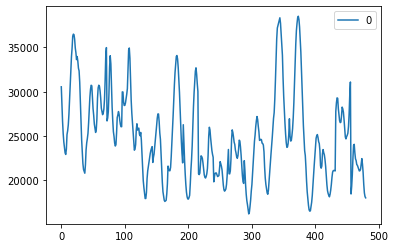

In [73]:
pd.DataFrame(actuals).plot()

<AxesSubplot:>

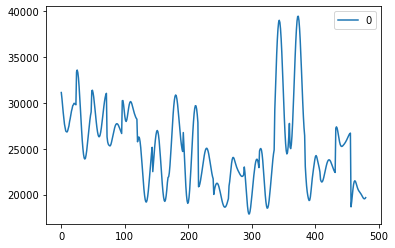

In [74]:
pd.DataFrame(predictions).plot()

In [35]:
# Combine flattened lists into DataFrame
compare = pd.DataFrame({'Predictions': predictions, 'Actuals': actuals})

Text(0.5, 0, 'Discontinuous time (in chunks used for cross-val)')

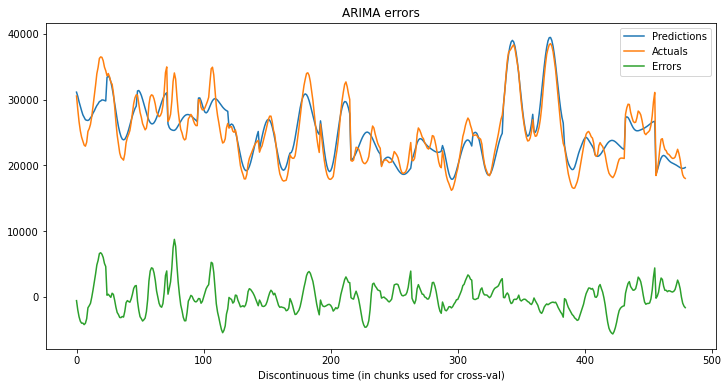

In [36]:
# Add errros
compare['Errors'] = compare['Actuals'] - compare['Predictions']
compare.plot(figsize=(12,6))
plt.title('ARIMA errors')
plt.xlabel('Discontinuous time (in chunks used for cross-val)')

In [37]:
# Calculate MAPE
np.mean(np.abs(compare['Errors'])/compare['Actuals'])

0.06784023562078333